In [10]:
from collections import defaultdict, Counter 
import colorsys
import itertools
import pickle 
import os
import shutil
import subprocess

import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
plt.switch_backend('agg')
import matplotlib.image as mpimg
from matplotlib.backends.backend_pdf import PdfPages
from PIL import Image
from PyPDF2 import PdfFileWriter, PdfFileReader, PdfFileMerger
import io
from reportlab.pdfgen import canvas
from reportlab.lib.pagesizes import letter

import ot
from scipy.spatial import distance, ConvexHull
from scipy.stats import spearmanr
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans
from sklearn.metrics import mutual_info_score, normalized_mutual_info_score
from sklearn.manifold import TSNE
import fcsparser 
from ete3 import Tree, TreeNode, TreeStyle, TextFace

data_dir = '.'

In [ ]:
supplementary_data = pd.read_csv('../Suppl.Table2.CODEX_paper_MRLdatasetexpression.csv')
supplementary_data = supplementary_data[['X.X', 'Y.Y', 'Z.Z', 'sample_Xtile_Ytile', 
                                         'CD45', 'Imaging phenotype cluster ID']]
supplementary_data.rename(columns={'X.X': 'X', 'Y.Y': 'Y', 'Z.Z': 'Z'}, inplace=True)
supplementary_data['CD45_int'] = supplementary_data['CD45'].astype(int)
ids_to_names = pd.read_csv('ClusterIDtoName.txt', sep='\t')
cell_lines = list(ids_to_names['ID'].values)
ids_to_names = dict(zip(ids_to_names['ID'].values, ids_to_names['Name'].values))
# remove dirt from supplementary data 
supplementary_annotations = pd.read_excel('../Suppl.Table2.cluster annotations and cell counts.xlsx')
dirt = supplementary_annotations.loc[supplementary_annotations['Imaging phenotype (cell type)'] == 'dirt', 'X-shift cluster ID']
supplementary_data = supplementary_data[~supplementary_data['Imaging phenotype cluster ID'].isin(dirt)]
supplementary_data['sample'] = supplementary_data['sample_Xtile_Ytile'].apply(lambda x: x.split('_')[0])
samples = ['BALBc-1', 'BALBc-2', 'BALBc-3', 'MRL-4', 'MRL-5', 'MRL-6', 'MRL-7', 'MRL-8', 'MRL-9']

def convert_coordinates(df, tile_length=1342, tile_width=1006):
    df_converted = df.copy()
    df_converted['tile_x'] = df_converted['sample_Xtile_Ytile'].apply(lambda x: int(x.split('_')[1][2])) - 1
    df_converted['tile_y'] = df_converted['sample_Xtile_Ytile'].apply(lambda x: int(x.split('_')[2][2])) - 1
    print('tile values in convert_coordinates')
    print(df_converted['tile_x'])
    print(df_converted['tile_y'])
    df_converted['X'] = tile_length * df_converted['tile_x'] + df_converted['X']
    df_converted['Y'] = tile_width * df_converted['tile_y'] + df_converted['Y']
    
    return df

def process_fcs(df):
    df.rename(columns={'F4': 'F480', 'CD16': 'CD1632', 'CD21': 'CD2135', 
                       'X.X': 'X', 'Y.Y': 'Y', 'Z.Z': 'Z'}, inplace=True)
    df['CD45_int'] = df['CD45'].astype(int)
    df = pd.merge(df, supplementary_data, on=['X', 'Y', 'Z', 'CD45_int'])
    print('Before convert coordinates')
    print(df[['X', 'Y', 'Z', 'sample_Xtile_Ytile']].head())
    print(df[['X', 'Y']].max())
    df = convert_coordinates(df)
    print('After convert coordinates')
    print(df[['X', 'Y', 'Z', 'sample_Xtile_Ytile']].head())
    print(df[['X', 'Y']].max())
    df['sample'] = df['sample_Xtile_Ytile'].apply(lambda x: x.split('_')[0])
    df.drop(['CD45_int'], axis=1, inplace=True)
    
    return df

def get_clusters(sample_name):
    #all_neighbors = list(reversed(range(5, 100+1)))
    all_neighbors = list(reversed(range(5, 500+1, 5)))
    nn_nums = []
    num_clusters = []
    for nn in all_neighbors:
        try:
            _, data = fcsparser.parse(data_dir + '/' + sample_name + '/' + str(nn) + '/out/' + sample_name + '.fcs') 
            clusters = len(np.unique(data['cluster_id']))
            if clusters < 300: # hacky method right now to reduce size of tree 
                num_clusters.append(clusters)
                nn_nums.append(nn)
        except:
            continue
            
    return num_clusters, nn_nums

def get_unique_clusters(sample_name):
    num_clusters, nn_nums = get_clusters(sample_name)
    dist_neighbors, dist_clusters = [], []
    for i in range(len(num_clusters)):
        if i > 0 and num_clusters[i] != num_clusters[i-1]:
            dist_neighbors.append(nn_nums[i])
            dist_clusters.append(num_clusters[i])
    
    return dist_clusters, dist_neighbors

In [12]:
def get_tree_depth(tree):
    if not tree.children:
        return 0 # return 0 for single node 
    else:
        return 1 + max([get_tree_depth(child) for child in tree.children])

def add_tree_layer(tree, leaves, clusters, proportions, child_coords, prop_filter):
    '''
    tree: tree that we want to add an additional layer to
    leaves: leaves of tree 
    clusters: number of clusters in the child layer
    proportions: nested dictionary containing id of parent and id of child and the proportion of cells 
                 contained in the parent that are also contained in the child 
    prop_filter: proportion of cells for edge between clusters to be created 
    '''
    child_nodes = {}
    for ind in range(len(clusters)):
        child_node_id = clusters[ind]
        child_nodes[child_node_id] = TreeNode(name=child_node_id)
        # add coordinate data to node 
        child_nodes[child_node_id].add_features(coords=child_coords[child_node_id]) 
        child_nodes[child_node_id].add_features(cluster_id=child_node_id)
    for child_node_id in proportions:
        # ensure that each child node is not added to more than one parent node 
        proportions_child = proportions[child_node_id]
        max_node_id = max(proportions_child, key=proportions_child.get)
        if proportions_child[max_node_id] > prop_filter:
            parent_node = leaves[max_node_id]
            parent_node.add_child(child_nodes[child_node_id])
                
    return tree, child_nodes
    
def build_tree(fcs_paths, num_neighbors, prop_filter=0.1):
    '''
    fcs_paths: dictionary of (cluster numbers, path)
    num_neighbors: number of neighbors used in X-shift 
    prop_filter: proportion of cells for edge between clusters to be created 
    '''
    # first initialize tree with 1 node at top and its children 
    tree = TreeNode(name=0)
    leaves = {0: tree}
    _, cluster_data_child = fcsparser.parse(fcs_paths[0])
    cluster_data_child = process_fcs(cluster_data_child)
    tree.add_features(coords=cluster_data_child[['X', 'Y', 'Z']])
    tree.add_features(cluster_id=0)
    child_cluster_counts = cluster_data_child['cluster_id'].value_counts()
    child_coords = cluster_data_child[['cluster_id', 'sample', 'X', 'Y', 'Z']]
    child_coords_groupby = child_coords.groupby('cluster_id')
    child_coords = {group: child_coords.loc[inds, ['X', 'Y', 'Z', 'sample']]
                    for group, inds in child_coords_groupby.groups.items()}
    clusters = list(child_cluster_counts.keys())
    child_cluster_counts /= child_cluster_counts.sum()
    proportions = {}
    for child_node_id, val in child_cluster_counts.iteritems():
        proportions[child_node_id] = {0: val}
    # set proportion filter to 0 for first layer, as everything is a child of the vertex
    tree, leaves = add_tree_layer(tree, leaves, clusters, proportions, child_coords, prop_filter=0)
    
    # build the rest of the tree 
    for ind, nn in enumerate(num_neighbors[:-1]):
        _, cluster_data_parent = fcsparser.parse(fcs_paths[ind])
        _, cluster_data_child = fcsparser.parse(fcs_paths[ind+1])
        cluster_data_parent = process_fcs(cluster_data_parent)
        cluster_data_child = process_fcs(cluster_data_child)
        
        child_cluster_counts = cluster_data_child['cluster_id'].value_counts()
        clusters = list(child_cluster_counts.keys())
        match_data_parent = cluster_data_parent[['X', 'Y', 'Z', 'cluster_id']].astype(int)
        match_data_child = cluster_data_child[['X', 'Y', 'Z', 'cluster_id']].astype(int)
        merged = pd.merge(match_data_parent, match_data_child, on=['X', 'Y', 'Z'])
        parent_clusters = merged['cluster_id_x'].tolist()
        child_clusters = merged['cluster_id_y'].tolist()
        child_coords = cluster_data_child[['cluster_id', 'sample', 'X', 'Y', 'Z']]
        print(child_coords[['X', 'Y', 'sample']].head())
        print(child_coords[['X', 'Y']].max())
        child_coords_groupby = child_coords.groupby('cluster_id')
        child_coords = {group: child_coords.loc[inds, ['X', 'Y', 'Z', 'sample']]
                        for group, inds in child_coords_groupby.groups.items()}
        proportions = defaultdict(Counter)
        for parent_cluster, child_cluster in zip(parent_clusters, child_clusters):
            proportions[child_cluster][parent_cluster] += 1/child_cluster_counts[child_cluster]
        tree, leaves = add_tree_layer(tree, leaves, clusters, proportions, child_coords, prop_filter)
        
    return tree 

def probability_neighbor_same_in_parent(node):
    '''
    Compute the probability that the nearest neighbor of 
    each child cluster point (with respect to the union of the child points
    and parent neighbors) is also in the cluster. 
    '''
    if node.coords.shape[0] == 1:
        return 0
    child_coords = node.coords[['X', 'Y']]
    child_coords['cluster'] = 'child'
    parent_coords = node.up.coords[['X', 'Y']]
    coords = pd.merge(child_coords, parent_coords, on=['X', 'Y'], how='outer')
    coords['cluster'] = coords['cluster'].apply(lambda x: 'child' if x == 'child' else 'parent')
    nbrs_model = NearestNeighbors(n_neighbors = 2).fit(coords[['X', 'Y']].values)
    _, indices = nbrs_model.kneighbors(child_coords[['X', 'Y']].values)
    nearest_in_parent = []
    coords_vals, child_coords_vals = coords[['X', 'Y']].values, child_coords[['X', 'Y']].values
    for ind, nearest_ind in enumerate(indices):
        if not np.array_equal(coords_vals[nearest_ind[0]], child_coords_vals[ind]):
            nearest_in_parent.append(nearest_ind[0])
        else:
            nearest_in_parent.append(nearest_ind[1])
    prob = np.mean(coords.loc[nearest_in_parent, 'cluster'] == 'child')
    
    return prob

def get_grid_counts(node, grid_size=25):
    '''
    Divide points into a grid, and get the count of the number of points
    in each grid cell in the child and parent. 
    '''
    x_max, y_max = node.coords['X'].max(), node.coords['Y'].max()
    x_length, y_length = x_max / grid_size, y_max / grid_size
    grid_coords = itertools.product(range(grid_size), range(grid_size))
    grid_x_child, grid_y_child = node.coords['X'] // x_length, node.coords['Y'] // y_length
    grid_child = Counter(zip(grid_x_child, grid_y_child))
    grid_x_parent, grid_y_parent = node.up.coords['X'] // x_length, node.up.coords['Y'] // y_length
    grid_parent = Counter(zip(grid_x_parent, grid_y_parent))
    grid_child_counts, grid_parent_counts = [], []
    for grid_coord_tuple in grid_coords:
        grid_child_counts.append(grid_child[grid_coord_tuple])
        grid_parent_counts.append(grid_parent[grid_coord_tuple])
        
    return grid_child_counts, grid_parent_counts

def spearman_corr_change(node, grid_size=25):
    '''
    Partition the image into a grid, and compute the fraction of cells in each cell of the grid. 
    We then compute the spearman correlation between the parent and child cluster using these values. 
    ''' 
    grid_child_counts, grid_parent_counts = get_grid_counts(node, grid_size)
    spearman_corr, _ = spearmanr(grid_child_counts, grid_parent_counts)
    
    return spearman_corr

In [13]:
def build_sample_tree(sample_name, prop_filter=0.1):
    num_clusters, num_neighbors = get_unique_clusters(sample_name)
    fcs_paths = [data_dir + '/' + sample_name + '/' + str(nn) + '/out/' + sample_name + '.fcs' 
                 for nn in num_neighbors]
    tree = build_tree(fcs_paths, num_neighbors, prop_filter)
    return tree

def hls2hex(h, l, s):
    return '#%02x%02x%02x' % tuple(map(lambda x: int(x*255),
                                      colorsys.hls_to_rgb(h, l, s)))    

def recreate_tree(tree, num_layers=None):
    # build tree with same topology but without the coordinate and metadata labels 
    # use color_dict to color nodes the appropriate colors 
    new_tree = TreeNode(name = tree.name)
    #new_tree = TreeNodeHashable(name = tree.name)
    new_tree.img_style['size'] = 10
    new_tree.img_style['fgcolor'] = tree.color
    new_tree.img_style['shape'] = 'sphere'
    old_layer = [tree]
    new_layer = [new_tree]
    layer_num = 0
    while old_layer:
        next_old_layer, next_new_layer = [], []
        for ind, node in enumerate(old_layer):
            for child in node.children:
                next_old_layer.append(child)
                new_child = TreeNode(name = child.name)
                #new_child = TreeNodeHashable(name = child.name)
                new_child.img_style['size'] = 10
                new_child.img_style['fgcolor'] = child.color
                new_child.img_style['shape'] = 'sphere'
                new_layer[ind].add_child(new_child)
                next_new_layer.append(new_child)
        old_layer = next_old_layer
        new_layer = next_new_layer
        layer_num += 1
        if num_layers is not None and layer_num == num_layers:
            break
        
    return new_tree

In [14]:
# create heatmaps of cell lines and how they branch out in the clustering 

def get_paths(tree, num_layers=None):
    if not tree.children or num_layers == 1:
        yield [tree]
    else:
        for subtree in tree.children:
            if num_layers is not None:
                subtree_paths = get_paths(subtree, num_layers - 1)
            else:
                subtree_paths = get_paths(subtree, None)
            for path in subtree_paths:
                yield [tree] + path      
                
def get_layers(tree, num_layers=None):
    layer = [tree]
    layer_num = 0
    while layer:
        if num_layers is not None and layer_num == num_layers:
            break
        layer_num += 1
        new_layer = []
        for node in layer:
            node.add_features(num_clusters=len(layer))
            new_layer += node.children
        layer = new_layer
        if layer:
            yield layer 
        
def get_path(tree, path_ind):
    # get path based on its index 
    if not tree.children:
        return [tree]
    child_ctr = 0
    for child in tree.children:
        if path_ind < child_ctr + len(child):
            return [tree] + get_path(child, path_ind - child_ctr)
        child_ctr += len(child)
    
def visualize_spearman_metric(num_layers=None, save=True):
    # visualize tree where we color each node based on the value of the spearman metric 
    tree.add_features(color=hls2hex(0.95, 0.95, 0.95))
    for node in tree.iter_descendants():
        node.add_features(color=hls2hex((1+node.metric)*0.475, (1+node.metric)*0.475, (1+node.metric)*0.475))

    new_tree = recreate_tree(tree, num_layers)
    ts = TreeStyle()
    ts.show_leaf_name = False
    ts.rotation = 90
    if save:
        new_tree.render('metric_tree.png', tree_style=ts)
    else:
        return new_tree.render('%%inline', tree_style=ts)
    
def visualize_path(sample_name, tree, path, path_ind, start=0, save=True):
    # visualize path in tree, starting from position start
    for node in tree.traverse():
        node.add_features(color=hls2hex(0.95, 0.95, 0.95))
    for node in path[start:]:
        node.add_features(color=hls2hex(0, 0, 0))
    new_vertex = path[start]
        
    new_tree = recreate_tree(new_vertex, num_layers=None)
    for node in path[start:]:
        node.add_features(color=hls2hex(0.95, 0.95, 0.95))
    ts = TreeStyle()
    ts.show_leaf_name = False
    ts.rotation = 90
    if save:
        if not os.path.isdir('Tree Paths ' + sample_name):
            os.mkdir('Tree Paths ' + sample_name)
        new_tree.render('Tree Paths {}/tree_path_{}.png'.format(sample_name, path_ind), tree_style=ts)
    else:
        return new_tree.render('%%inline', tree_style=ts)
    
def calculate_spearman_metric(tree):
    for node in tree.iter_descendants():
        node.add_features(metric=spearman_corr_change(node))
        node.add_features(prob=probability_neighbor_same_in_parent(node))
    layer = [tree]
    while layer:
        new_layer = set()
        for node in layer:
            node.add_features(num_clusters=len(layer))
            new_layer.update(node.children)
        layer = new_layer
        
    return tree
    
def parse_metric_tree(tree, num_layers=None, cutoff=0.5):
    # remove cluster nodes with spearman correlation less than cutoff
    parsed_tree = tree.copy(method='deepcopy')
    metric_vals = calculate_spearman_metric(parsed_tree)
    for node in parsed_tree.iter_descendants():
        metric = metric_vals[node]
        if metric > cutoff:
            node.delete(prevent_nondicotomic=False)
            
    del metric_vals

    ts = TreeStyle()
    ts.show_leaf_name = False
    ts.rotation = 90
    return parsed_tree.render('%%inline', tree_style=ts)

def get_intersection(layer, suppl_image_coords):
    overlap = np.zeros((len(layer), len(suppl_image_coords)))
    for ind1, node in enumerate(layer):
        node_coords = node.coords
        for ind2, image_coords in enumerate(suppl_image_coords):
            intersection = pd.merge(image_coords, node_coords, how='inner', on=['X', 'Y', 'Z', 'sample']).shape[0]
            union = pd.merge(image_coords, node_coords, how='outer', on=['X', 'Y', 'Z', 'sample']).shape[0]
            ratio = intersection / union
            overlap[ind1, ind2] = ratio
    print(overlap)
            
    return overlap

def get_image_coords(supplementary_data):
    suppl_image_groups = convert_coordinates(supplementary_data).groupby('Imaging phenotype cluster ID')
    labels = [ids_to_names[group_id] for group_id, _ in suppl_image_groups]
    suppl_image_coords = [group for _, group in suppl_image_groups]
    return labels, suppl_image_coords

def annotate_optimal_layer(labels, cost_matrix, layer):
    for ind, node in enumerate(layer):
        prop_dict = dict(zip(labels, cost_matrix[ind]))
        node.add_features(prop_dict=prop_dict)
                
def get_node_cell_type_intersection(tree):
    # find the amount of intersection each node has with each cell type 
    labels, suppl_image_coords = get_image_coords(supplementary_data)
    layers = list(get_layers(tree))
    cost_matrices, costs = [], []
    for layer_ind, layer in enumerate(layers):
        if len(layer) == 0:
            continue
        print('Layer', layer_ind, 'number of nodes', len(layer))
        node_prop = np.array([node.coords.shape[0] for node in layer])
        node_prop = node_prop / node_prop.sum()
        suppl_prop = np.array([image_coords.shape[0] for image_coords in suppl_image_coords])
        suppl_prop = suppl_prop / suppl_prop.sum()
        cost_matrix = get_intersection(layer, suppl_image_coords)
        transport_matrix, log = ot.emd(node_prop, suppl_prop, 1 - cost_matrix, log=True) 
        costs.append(log['cost'])
        cost_matrices.append(cost_matrix)
    cost_min_ind = np.argmin(costs)
    cost_matrix = cost_matrices[cost_min_ind]
    layer = layers[cost_min_ind]
    print('Optimal layer is {} with {} clusters.'.format(cost_min_ind, len(layer)))
    annotate_optimal_layer(labels, cost_matrix, layer)
             
def get_intersecting_cell_types(path, num_types=2):
    # get the num_paths most intersecting cell types with the path 
    prop_dict = {}
    for node in path[1:]:
        if hasattr(node, 'prop_dict'):
            prop_dict = node.prop_dict
            break     
    if not prop_dict:
        return ''
    else:
        densest = sorted(prop_dict, key=prop_dict.get)[-num_types:]
        return densest 
            
def plot_path(path, path_ind):
    # hacky function to plot path in tree
    if not os.path.isdir('Graphs'):
        os.mkdir('Graphs')
    output_file = 'Graphs/path_{}.pdf'.format(path_ind)
    pdf = PdfPages(output_file)
    img = mpimg.imread('Tree Paths/tree_path_{}.png'.format(path_ind))
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.axis('off')
    pdf.savefig(fig)
    
    pp = []
    for node in path[1:]:
        pp.append([node.num_clusters, node.metric])
    pp = np.array(pp)
    
    fig, ax = plt.subplots()
    ax.plot(np.array(pp[:, 1]).T, np.arange(len(pp)))
    ax.invert_yaxis()
    ax.set_yticks(np.arange(len(pp)))
    ax.set_yticklabels(pp[:, 0])
    pdf.savefig(fig)
    
    for ind, node in enumerate(path[1:]):
        if ind % 5 == 0:
            fig, ax = plt.subplots(1, 5, figsize=(20, 4))
        scatter = ax[ind%5].scatter(node.coords['X'], node.coords['Y'], s=0.1)
        ax[ind%5].set_title('Clusters = {}, Prob = {}'.format(int(pp[ind][0]), np.round(pp[ind][1], 2)))
        if ind % 5 == 4:
            pdf.savefig(fig)
    if ind % 5 != 4:
        for i in range(1, 5 - ind%5):
            ax[ind%5 + i].axis('off')
        pdf.savefig(fig)
    pdf.close()
    
    # add the cell types that the path has maximum intersection with 
    cell_types = get_intersecting_cell_types(path, num_types=2)
    packet = io.BytesIO()
    can = canvas.Canvas(packet, pagesize=letter)
    can.drawString(10, 100, 'Cell types with greatest intersection with path: {} and {}'.format(*cell_types))
    can.save()
    packet.seek(0)
    new_pdf = PdfFileReader(packet)
    existing_pdf = PdfFileReader(open(output_file, "rb"))
    output = PdfFileMerger()
    #page = existing_pdf.getPage(0)
    #page.mergePage(new_pdf.getPage(0))
    #output.addPage(page)
    output.append(existing_pdf)
    output.append(new_pdf)
    output.write(output_file)

## Generate HTMLs for BALBc-1

In [10]:
'''
sample_name = 'BALBc-1'
#num_clusters, num_neighbors = get_unique_clusters(sample_name)
#fcs_paths = [data_dir + '/' + sample_name + '/' + str(nn) + '/out/' + sample_name + '.fcs' for nn in num_neighbors]
#tree = build_sample_tree(sample_name, prop_filter=0.15)
#tree = calculate_spearman_metric(tree)
#tree = get_node_cell_type_intersection(tree)
#pickle.dump(tree, open('tree_BALBc-1_for_html.pkl', 'wb'))
tree = pickle.load(open('tree_BALBc-1_for_html.pkl', 'rb'))
visualize_spearman_metric(num_layers=25, save=True)
if not os.path.isdir('Paths_{}'.format(sample_name)):
    os.mkdir('Paths_{}'.format(sample_name))
for ind, path in enumerate(get_paths(tree, num_layers=None)):
    if ind % 10 == 0:
        print('Dumped {} paths'.format(ind))
    visualize_path(sample_name, tree, path, ind, start=0, save=True)
    pickle.dump(path, open('Paths_{}/'.format(sample_name) + str(ind) + '.pkl', 'wb'))
'''

Dumped 0 paths
Dumped 10 paths
Dumped 20 paths
Dumped 30 paths
Dumped 40 paths
Dumped 50 paths
Dumped 60 paths
Dumped 70 paths
Dumped 80 paths
Dumped 90 paths
Dumped 100 paths
Dumped 110 paths
Dumped 120 paths
Dumped 130 paths
Dumped 140 paths
Dumped 150 paths
Dumped 160 paths
Dumped 170 paths
Dumped 180 paths
Dumped 190 paths
Dumped 200 paths


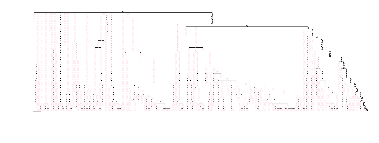

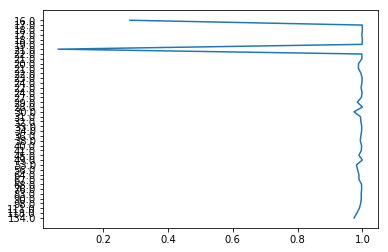

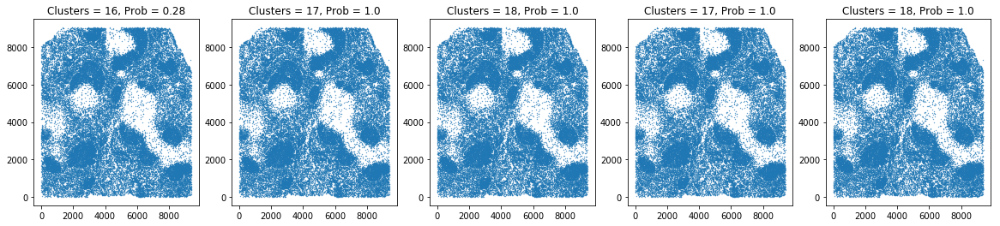

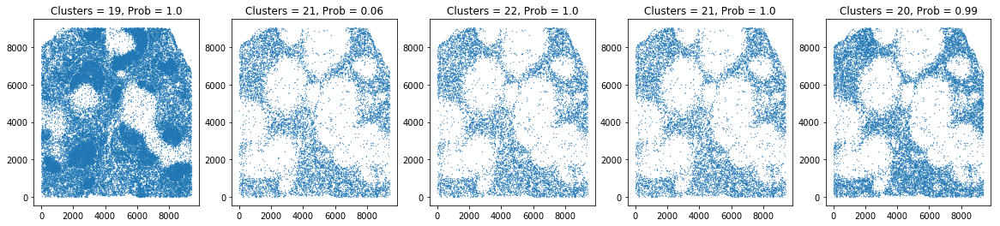

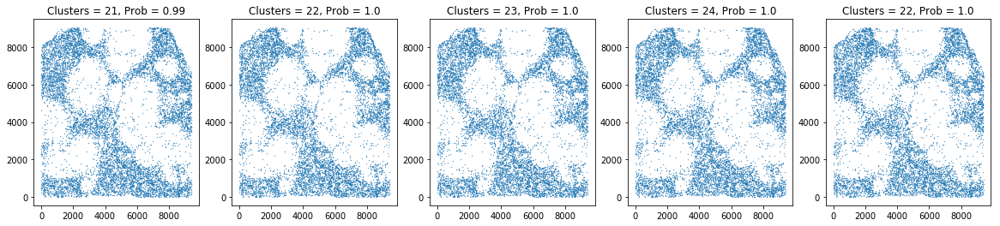

...

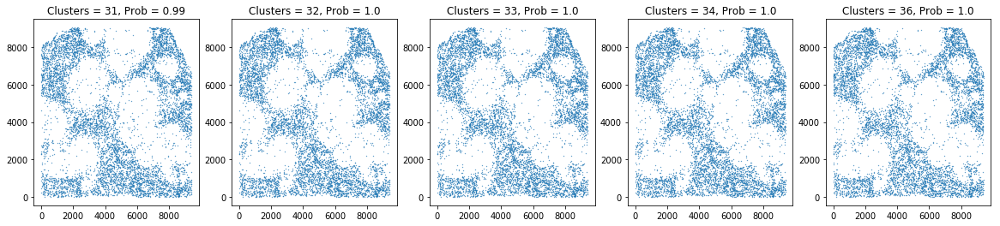

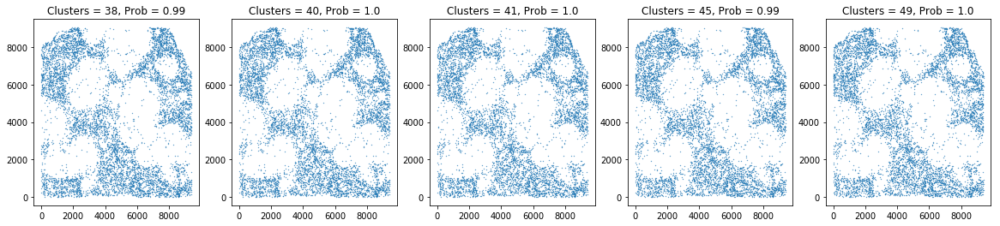

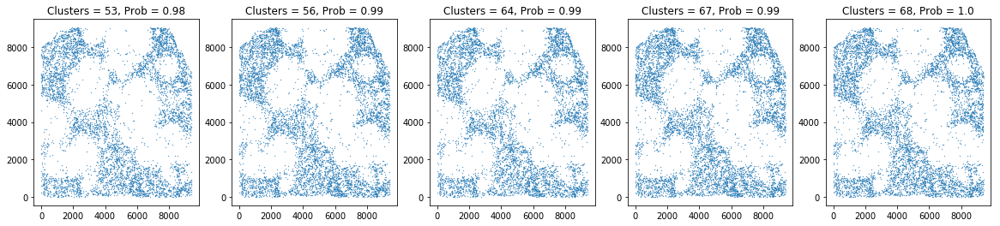

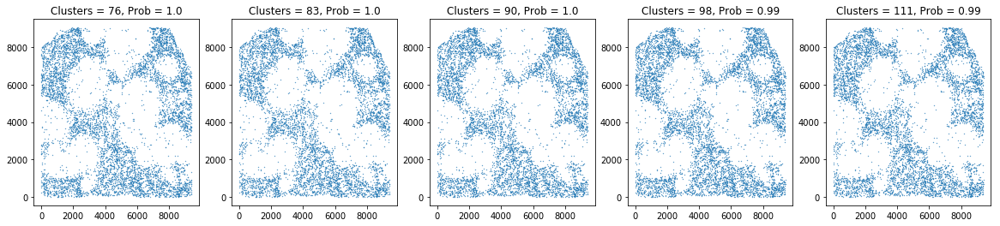

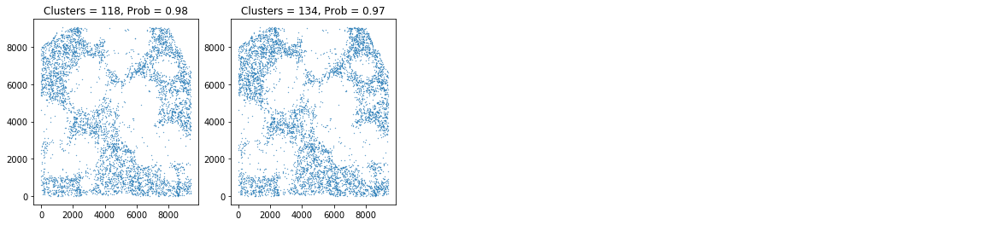

In [14]:
'''
sample_name = 'BALBc-1'
num_clusters, num_neighbors = get_unique_clusters(sample_name)
fcs_paths = [data_dir + '/' + sample_name + '/' + str(nn) + '/out/' + sample_name + '.fcs' for nn in num_neighbors]
tree = build_sample_tree(sample_name, prop_filter=0.15)
tree = calculate_spearman_metric(tree)
tree = get_node_cell_type_intersection(tree)
pickle.dump(tree, open('tree_BALBc-1.pkl', 'wb'))
path = next(get_paths(tree, num_layers=None))
plot_path(path, 0)
'''

In [ ]:
'''
import os
import subprocess
sample_name = 'BALBc-1'
for i in range(len(os.listdir('Paths_{}/'.format(sample_name)))):
    if i % 10 == 0:
        print('Submitting job', i)
    subprocess.Popen('sbatch draw_path.sh {} {}'.format(sample_name, i), shell=True)
'''

## Generate HTMLs for Combined Samples 

In [15]:
def write_metric_graph(path, path_ind):
    # save metric graph to separate directory
    if not os.path.isdir('Metric_Graphs_Combined'):
        os.mkdir('Metric_Graphs_Combined')
    if not os.path.isdir('Probability_Graphs_Combined'):
        os.mkdir('Probability_Graphs_Combined')
    
    pp = []
    for node in path[1:]:
        pp.append([node.num_clusters, node.metric, node.prob])
    pp = np.array(pp)
    
    fig, ax = plt.subplots()
    ax.plot(np.array(pp[:, 1]).T, np.arange(len(pp)))
    ax.invert_yaxis()
    ax.set_yticks(np.arange(len(pp)))
    ax.set_yticklabels(pp[:, 0])
    cell_types = get_intersecting_cell_types(path, num_types=2)
    if cell_types:
        ax.set_title('{}, {}'.format(cell_types[0], cell_types[1]))
    plt.savefig('Metric_Graphs_Combined/metric_graph_{}.png'.format(path_ind))
    
    fig, ax = plt.subplots()
    ax.plot(np.array(pp[:, 2]).T, np.arange(len(pp)))
    ax.invert_yaxis()
    ax.set_yticks(np.arange(len(pp)))
    ax.set_yticklabels(pp[:, 0])
    if cell_types:
        ax.set_title('{}, {}'.format(cell_types[0], cell_types[1]))
    plt.savefig('Probability_Graphs_Combined/prob_graph_{}.png'.format(path_ind))
    
def plot_path_clusters(path, path_ind, depth):
    # write clusters to their own png files 
    output_dir = 'Clusters_Combined/Clusters_{}'.format(path_ind)
    if not os.path.isdir(output_dir):
        os.makedirs(output_dir)
    
    for node_ind in range(depth):
        fig, ax = plt.subplots(3, 3, figsize=(15, 15))
        if node_ind < len(path) - 1:
            node = path[node_ind+1]
            fig.suptitle('Layer {}, Clusters = {}'.format(node_ind, node.num_clusters))
            coords = node.coords.copy()
            for ind, sample in enumerate(samples):
                sample_coords = coords[coords['sample'] == sample]
                print(sample_coords['X'].max(), sample_coords['Y'].max())
                scatter = ax[ind//3][ind%3].scatter(sample_coords['X'], sample_coords['Y'], s=0.1)
                ax[ind//3][ind%3].set_title(sample)
        else:
            for ind, sample in enumerate(samples):
                scatter = ax[ind//3][ind%3].scatter([], [])
                ax[ind//3][ind%3].set_title(sample)
        fig.savefig(output_dir + '/' + 'clusters_{}_{}.png'.format(path_ind, node_ind))
        
    shutil.make_archive(output_dir, 'gztar', output_dir)
    shutil.rmtree(output_dir)

def plot_path_combined(path, path_ind):
    # hacky function to plot path in tree
    if not os.path.isdir('Graphs_Combined'):
        os.mkdir('Graphs_Combined')
    output_file = 'Graphs_Combined/path_{}.pdf'.format(path_ind)
    pdf = PdfPages(output_file)
    img = mpimg.imread('Tree Paths combined/tree_path_{}.png'.format(path_ind))
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.axis('off')
    pdf.savefig(fig)
    
    pp = []
    for node in path[1:]:
        pp.append([node.num_clusters, node.metric])
    pp = np.array(pp)
    
    fig, ax = plt.subplots()
    ax.plot(np.array(pp[:, 1]).T, np.arange(len(pp)))
    ax.invert_yaxis()
    ax.set_yticks(np.arange(len(pp)))
    ax.set_yticklabels(pp[:, 0])
    cell_types = get_intersecting_cell_types(path, num_types=2)
    ax.set_title('{}, {}'.format(cell_types[0], cell_types[1]))
    pdf.savefig(fig)
    
    for ind, node in enumerate(path[1:]):
        fig, ax = plt.subplots(3, 3, figsize=(15, 15))
        fig.suptitle('Layer {}, Clusters = {}'.format(ind, int(pp[ind][0])))
        coords = node.coords.copy()
        for ind, sample in enumerate(samples):
            sample_coords = coords[coords['sample'] == sample]
            scatter = ax[ind//3][ind%3].scatter(sample_coords['X'], sample_coords['Y'], s=0.1)
            ax[ind//3][ind%3].set_title(sample)
        pdf.savefig(fig)
    pdf.close()
    
    # add the cell types that the path has maximum intersection with 
    cell_types = get_intersecting_cell_types(path, num_types=2)
    packet = io.BytesIO()
    can = canvas.Canvas(packet, pagesize=letter)
    can.drawString(10, 100, 'Cell types with greatest intersection with path: {} and {}'.format(*cell_types))
    can.save()
    packet.seek(0)
    new_pdf = PdfFileReader(packet)
    existing_pdf = PdfFileReader(open(output_file, "rb"))
    output = PdfFileMerger()
    #page = existing_pdf.getPage(0)
    #page.mergePage(new_pdf.getPage(0))
    #output.addPage(page)
    output.append(existing_pdf)
    output.append(new_pdf)
    output.write(output_file)

In [20]:

sample_name = 'combined'
#num_clusters, num_neighbors = get_unique_clusters(sample_name)
#pickle.dump((num_clusters, num_neighbors), open('unique_clusters_combined.pkl', 'wb'))
num_clusters, num_neighbors = pickle.load(open('unique_clusters_combined.pkl', 'rb'))
print('Got clusters and neighbors.')
fcs_paths = [data_dir + '/' + sample_name + '/' + str(nn) + '/out/' + sample_name + '.fcs' 
             for nn in num_neighbors]
tree = build_sample_tree(sample_name, prop_filter=0.15)
for node in tree.traverse():
    print(node.coords.head())
print('Built tree.')
tree = calculate_spearman_metric(tree)
print('Calculated spearman metric.')
layer = list(get_layers(tree))[32]
labels, suppl_image_coords = get_image_coords(supplementary_data)
cost_matrix = get_intersection(layer, suppl_image_coords)
annotate_optimal_layer(labels, cost_matrix, layer)
#get_node_cell_type_intersection(tree)
print('Got intersections with cell types.')
pickle.dump(tree, open('tree_combined_for_html.pkl', 'wb'))


Got clusters and neighbors.
Before convert coordinates
      X      Y    Z sample_Xtile_Ytile
0  15.0  221.0  9.0    BALBc-1_X01_Y01
1  12.0  444.0  9.0    BALBc-1_X01_Y01
2  16.0  367.0  9.0    BALBc-1_X01_Y01
3   7.0  625.0  9.0    BALBc-1_X01_Y01
4  12.0  464.0  7.0    BALBc-1_X01_Y01
X    1342.0
Y    1006.0
dtype: float32
After convert coordinates
      X      Y    Z sample_Xtile_Ytile
0  15.0  221.0  9.0    BALBc-1_X01_Y01
1  12.0  444.0  9.0    BALBc-1_X01_Y01
2  16.0  367.0  9.0    BALBc-1_X01_Y01
3   7.0  625.0  9.0    BALBc-1_X01_Y01
4  12.0  464.0  7.0    BALBc-1_X01_Y01
X    1342.0
Y    1006.0
dtype: float32
Before convert coordinates
      X      Y    Z sample_Xtile_Ytile
0  15.0  221.0  9.0    BALBc-1_X01_Y01
1  12.0  444.0  9.0    BALBc-1_X01_Y01
2  16.0  367.0  9.0    BALBc-1_X01_Y01
3   7.0  625.0  9.0    BALBc-1_X01_Y01
4  12.0  464.0  7.0    BALBc-1_X01_Y01
X    1342.0
Y    1006.0
dtype: float32
After convert coordinates
      X      Y    Z sample_Xtile_Ytile
0  15.0 

KeyboardInterrupt: 

In [9]:
'''
sample_name = 'combined'
tree = pickle.load(open('tree_combined_for_html.pkl', 'rb'))
for ind, path in enumerate(get_paths(tree, num_layers=None)):
    if ind % 10 == 0:
        print('Dumped {} paths'.format(ind))
    visualize_path(sample_name, tree, path, ind, start=0, save=True)
    write_metric_graph(path, ind)
'''

"\nsample_name = 'combined'\ntree = pickle.load(open('tree_combined_for_html.pkl', 'rb'))\nfor ind, path in enumerate(get_paths(tree, num_layers=None)):\n    if ind % 10 == 0:\n        print('Dumped {} paths'.format(ind))\n    visualize_path(sample_name, tree, path, ind, start=0, save=True)\n    write_metric_graph(path, ind)\n"

/n/home05/aewhatley/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


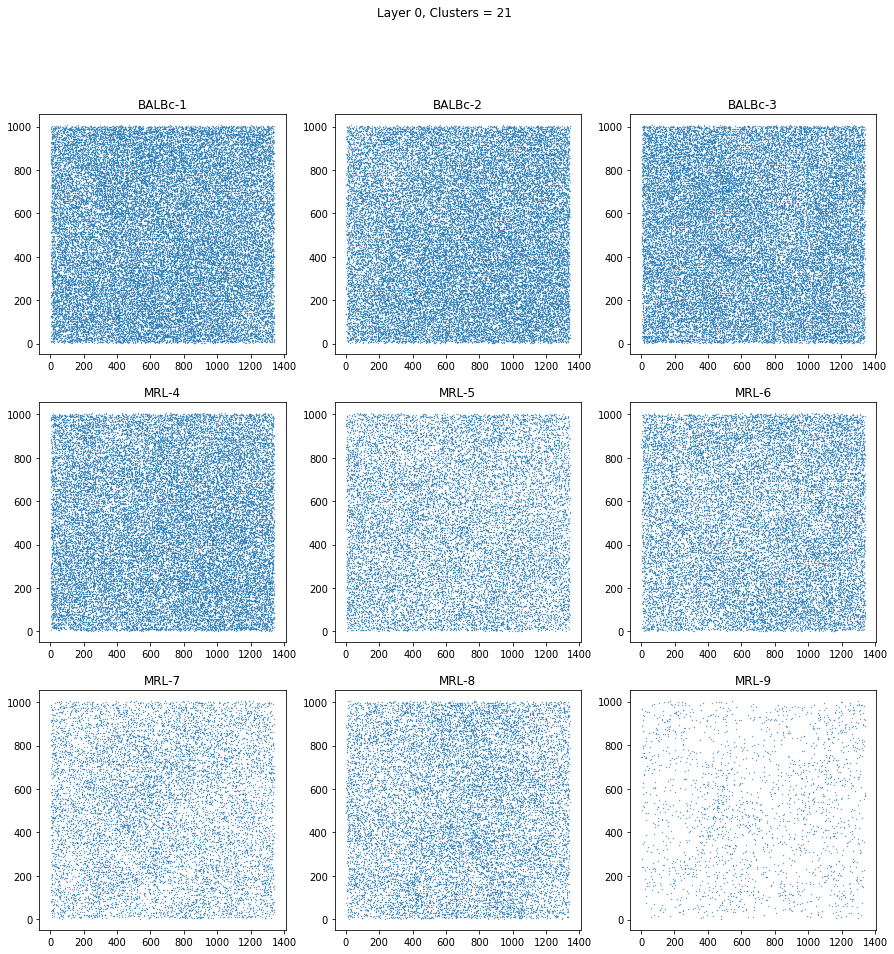

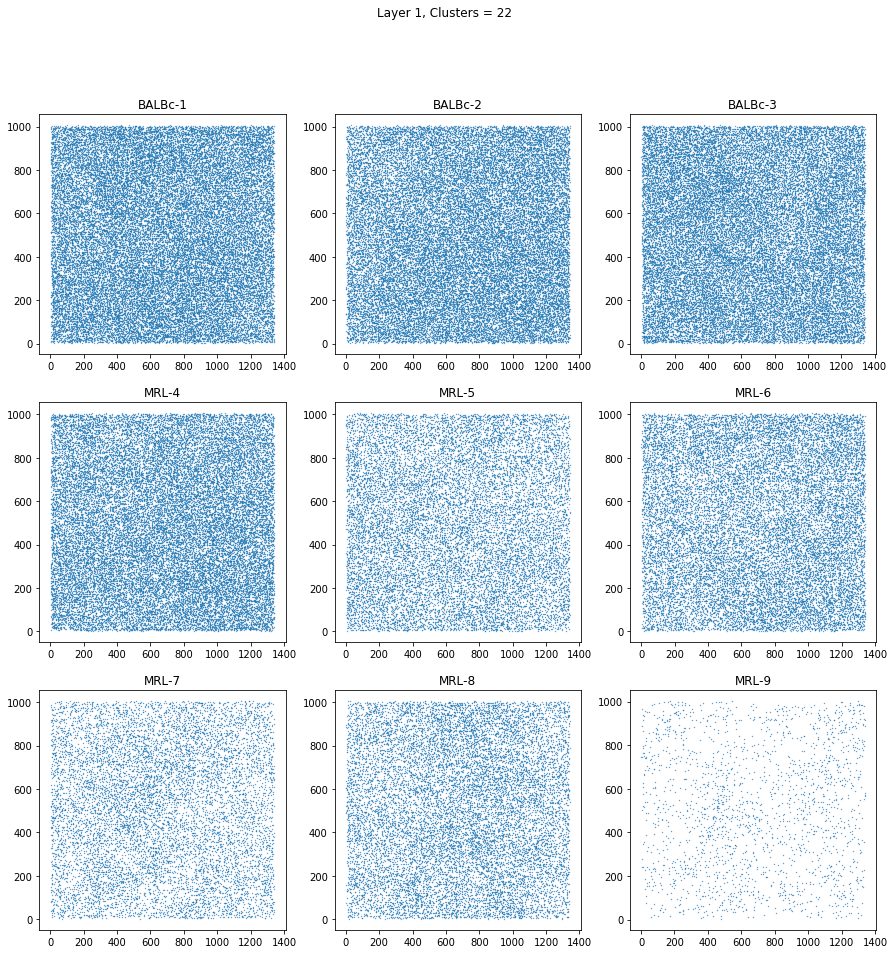

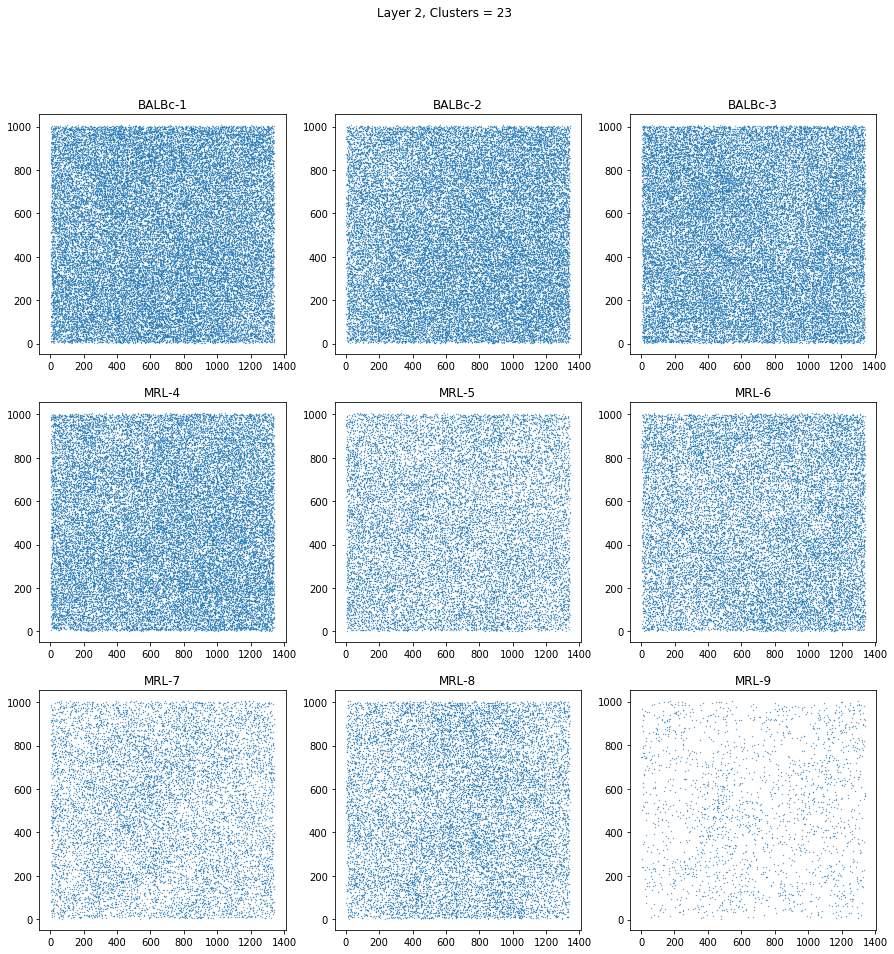

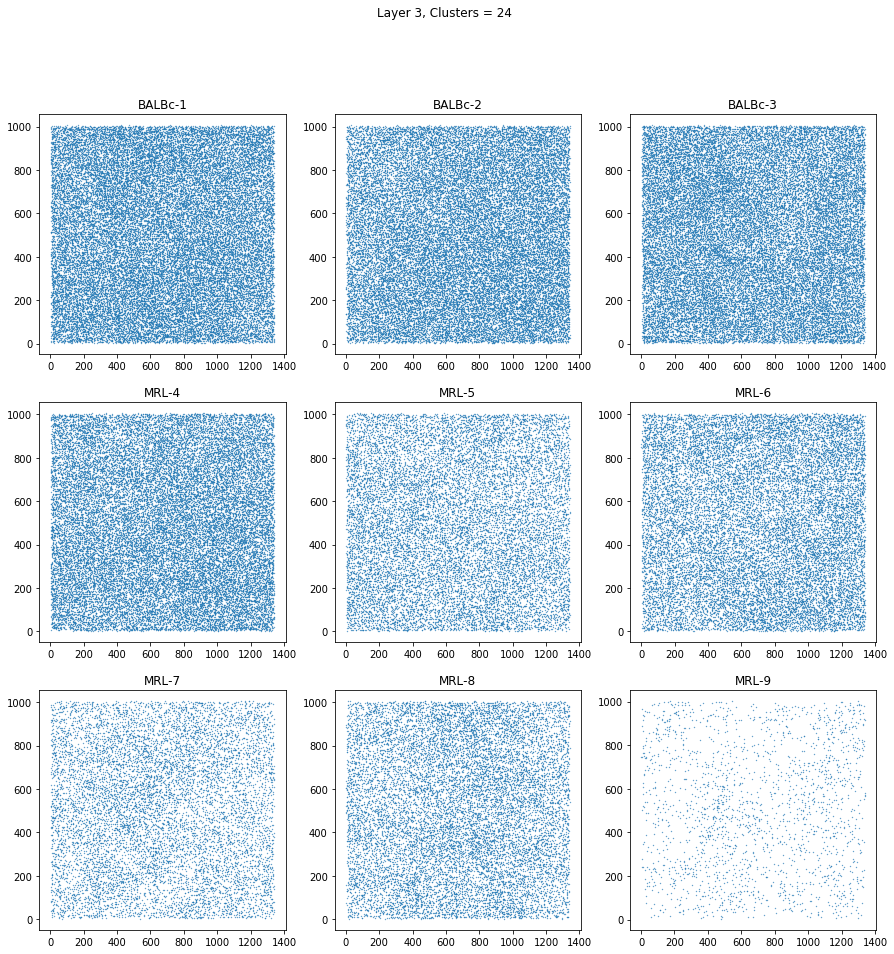

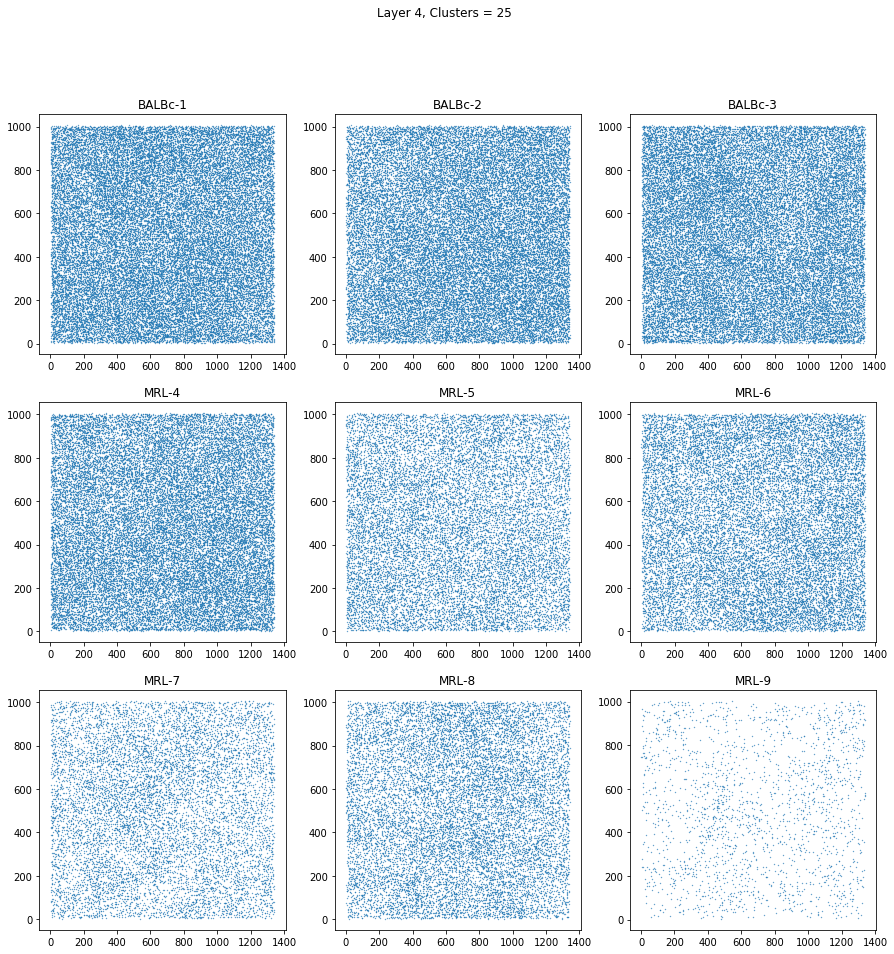

...

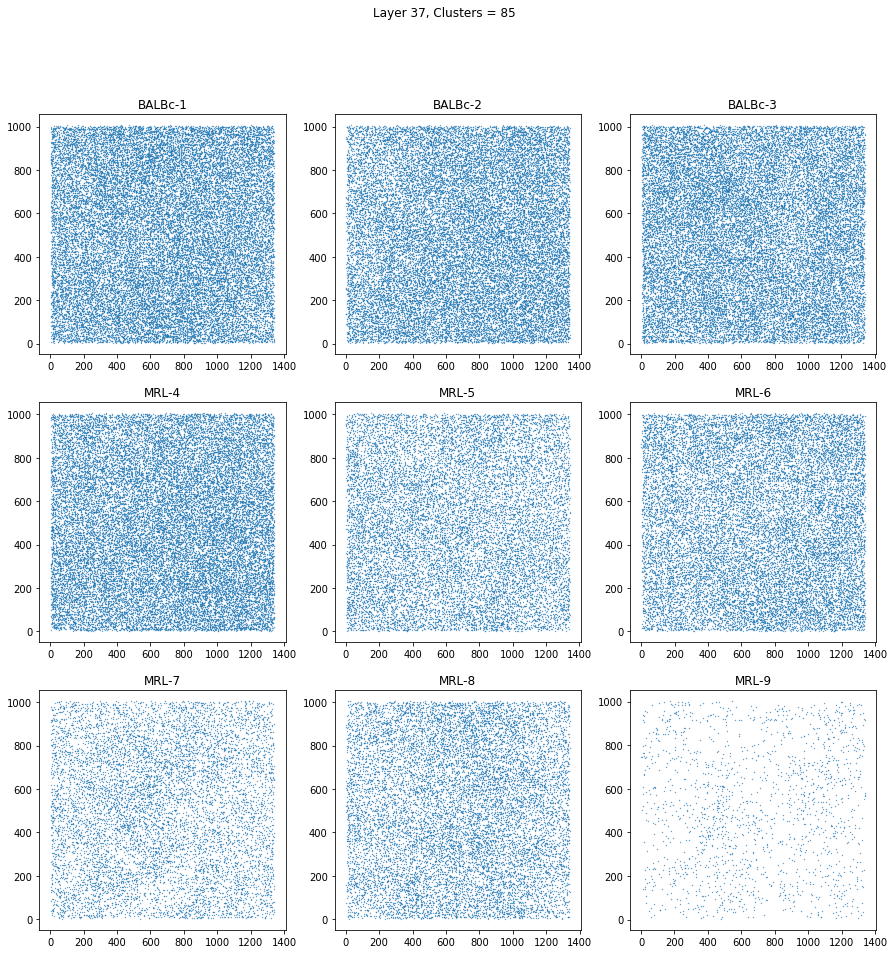

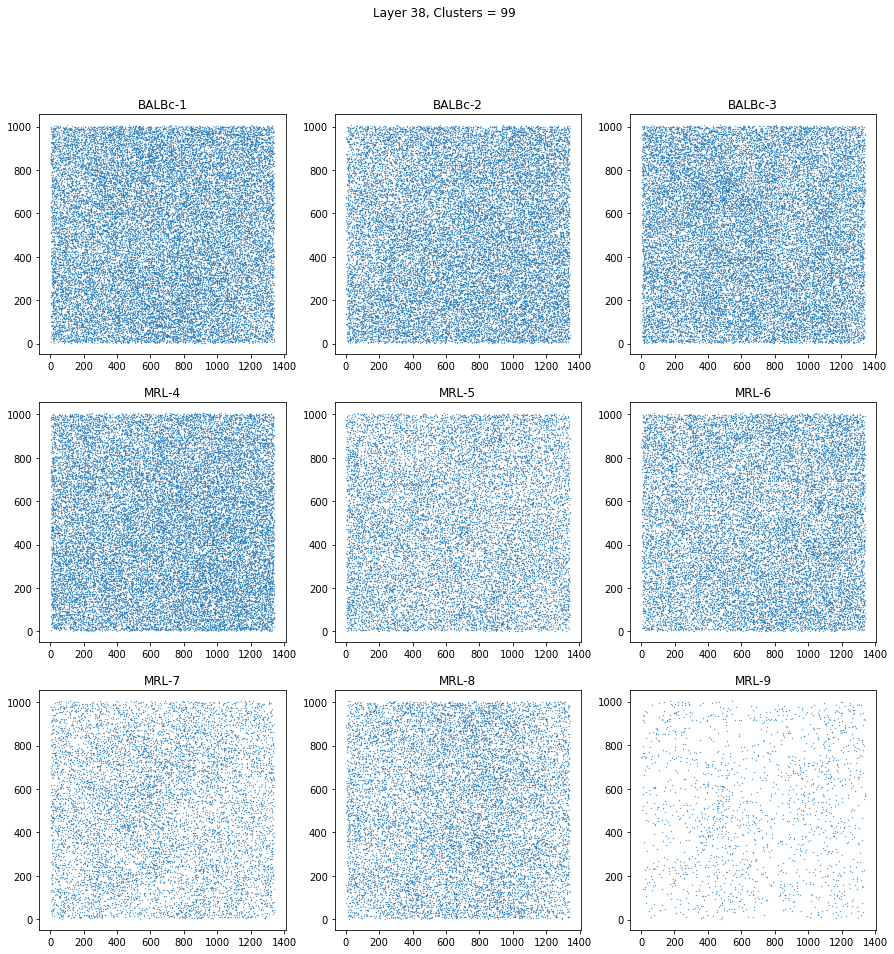

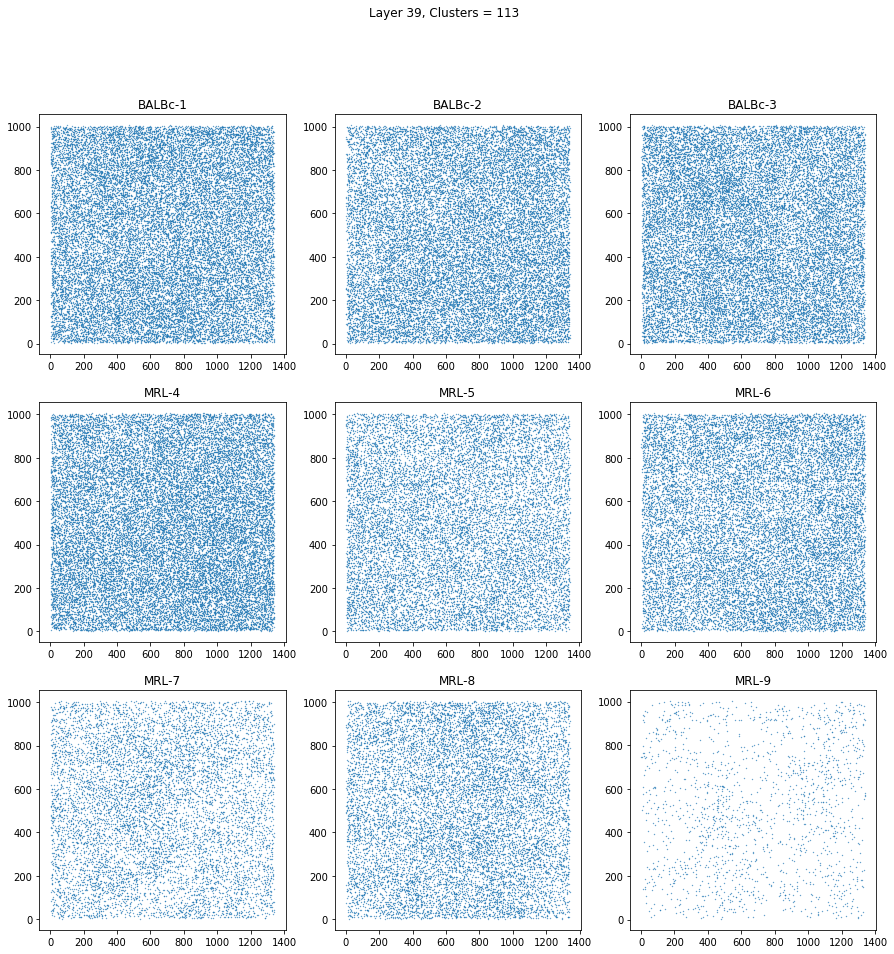

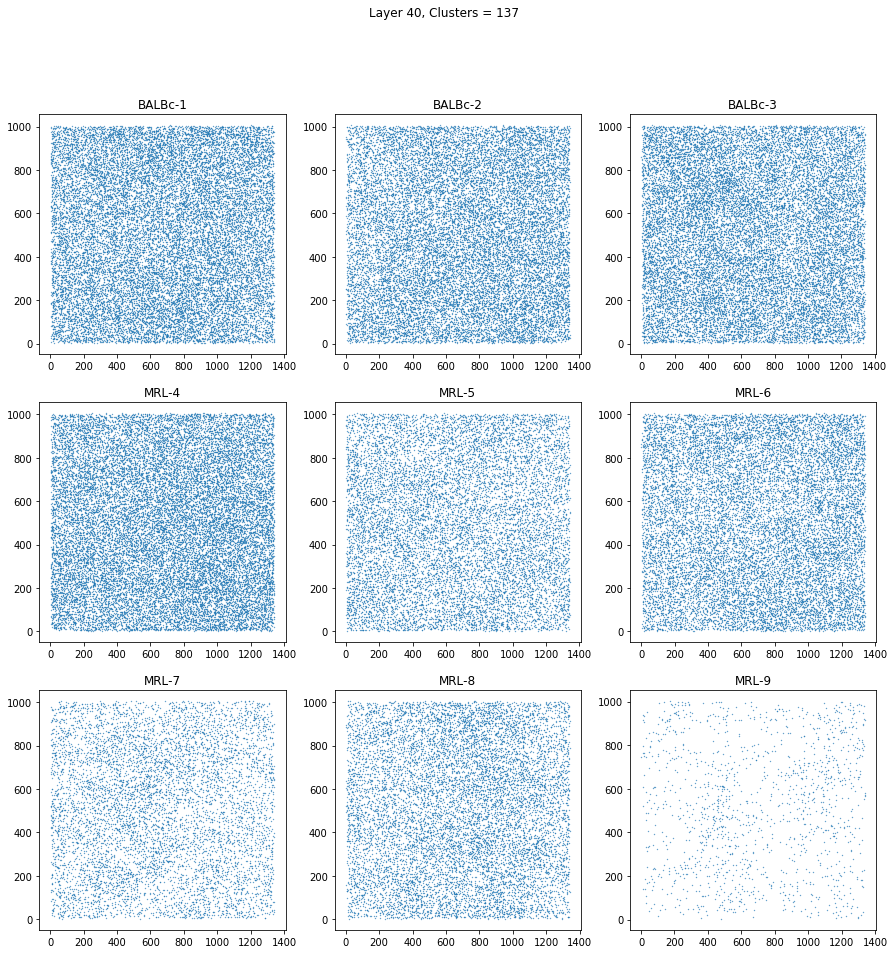

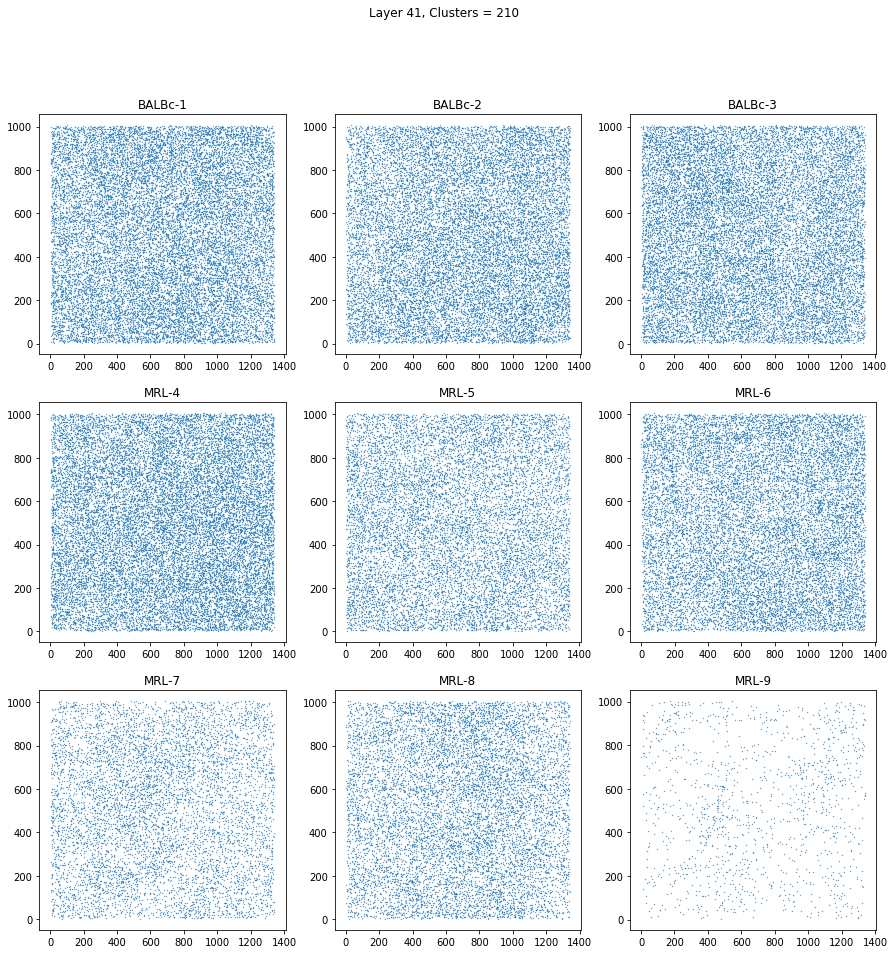

In [19]:
'''
sample_name = 'combined'
tree = pickle.load(open('tree_combined_for_html.pkl', 'rb'))
path = next(get_paths(tree))
depth = get_tree_depth(tree)
plot_path_clusters(path, 0, depth)
'''

In [ ]:
'''
import os
import subprocess
sample_name = 'combined'
for i in range(len(os.listdir('Paths_{}/'.format(sample_name)))):
    if i % 10 == 0:
        print('Submitting job', i)
    subprocess.Popen('sbatch draw_path.sh {}'.format(i), shell=True)
'''